In [ ]:
import os, sys 
#to be able to interact with Google Drive's operating system
from google.colab import drive 
#drive is a module that allows us use Python to interact with google drive
drive.mount('/content/gdrive') 
#mounting google drive allows us to work with its contents
nb_path = '/content/notebooks'
os.symlink('/content/gdrive/My Drive/Colab Notebooks', nb_path)
sys.path.insert(0, nb_path)  # or append(nb_path)

In [8]:
import pandas as pd
import numpy as np
from epigenomic_dataset import active_promoters_vs_inactive_promoters
from epigenomic_dataset import active_enhancers_vs_inactive_enhancers
import matplotlib.pyplot as plt
from cache_decorator import Cache
from typing import Dict, List, Tuple, Optional
import seaborn as sns
from scipy.stats import pearsonr, spearmanr, entropy, wilcoxon
from minepy import MINE
from tqdm.auto import tqdm
from sklearn.metrics.pairwise import euclidean_distances
from typing import Tuple

from tensorflow.keras.layers import Input, Dense, Dropout, BatchNormalization, ReLU, Concatenate, Layer
from tensorflow.keras.layers import Conv1D, MaxPool1D, GlobalAveragePooling2D, GlobalMaxPool1D, Flatten,Reshape,ReLU, GlobalAveragePooling1D,ActivityRegularization
from tensorflow.keras import regularizers,Sequential
from tensorflow.keras.models import Model,Sequential
from extra_keras_metrics import get_complete_binary_metrics
from tensorflow.keras.callbacks import EarlyStopping
from epigenomic_dataset.utils import normalize_epigenomic_data
from keras_mixed_sequence import MixedSequence, VectorSequence
from keras_bed_sequence import BedSequence
from epigenomic_dataset.utils import get_cell_lines

In [ ]:
import warnings
warnings.filterwarnings('ignore')


# **RETRIEVAL OF ENCODE EPIGENOMIC DATA**

We use the *epigenomic_dataset* Python package to extract epigenomic data relative to HEK293 cell line and  hg38 assembly genome. 

In [10]:
window_size = 256
cell_line="HEK293"
assembly = "hg38"

In [ ]:
promoters_epigenomes, promoters_labels = active_promoters_vs_inactive_promoters(
    cell_line = cell_line,
    dataset = "fantom",
    window_size = window_size,
    binarize = True,
    min_active_tpm_value = 1,
    max_inactive_tpm_value = 1,
    
)

enhancers_epigenomes, enhancers_labels = active_enhancers_vs_inactive_enhancers(
    cell_line = cell_line,
    dataset = "fantom",
    window_size = window_size,
    binarize = True,
    min_active_tpm_value = 0,
    max_inactive_tpm_value = 0,
)

In [ ]:
epigenomes = {
    "promoters": promoters_epigenomes,
    "enhancers": enhancers_epigenomes
}

labels = {
    "promoters": promoters_labels,
    "enhancers": enhancers_labels
}

In [ ]:
labels['promoters']['HEK293'] = labels['promoters']['HEK293'].replace([False,True],[0,1])

In [ ]:
labels['enhancers']['HEK293'] = labels['enhancers']['HEK293'].replace([False,True],[0,1])

# **RATE BETWEEN FEATURES AND SAMPLES**


To avoid overfitting, it is important that the number of samples is greter than the number of features

In [ ]:
for region, x in epigenomes.items():
    print(
        f"The rate between features and samples for {region} data is: {x.shape[0]/x.shape[1]}"
    )
   

The rate between features and samples for promoters data is: 509.5969387755102
The rate between features and samples for enhancers data is: 322.8826530612245


# **GENOMIC SEQUENCE RETRIEVAL**

In order to retrieve sequence data of promoters and enhancers , we use the ucsc_genomes_downloader python package.

In [11]:
from ucsc_genomes_downloader import Genome

genome = Genome(assembly)

Loading chromosomes for genome hg38:   0%|          | 0/25 [00:00<?, ?it/s]

In [ ]:
print("The chromosomes in the human genome are: {}.".format(", ".join(genome)))

The chromosomes in the human genome are: chr1, chrM, chr21, chr22, chrY, chr19, chr20, chr18, chr17, chr16, chr15, chr14, chr13, chr12, chr10, chr11, chr9, chr8, chrX, chr7, chr6, chr5, chr4, chr3, chr2.


In [12]:
def to_bed(data:pd.DataFrame)->pd.DataFrame:
    """Return bed coordinates from given dataset."""
    return data.reset_index()[data.index.names]

#display(to_bed(epigenomes["promoters"])[:5])

In [ ]:
genome.bed_to_sequence(to_bed(epigenomes["promoters"])[:2])

array(['AAATGGTCATCCATCCTTTGGCCCCAATACCTAAACTAAGGTCTATGAACAATAAGATGATTTTCTTCAGTGGGACTTTTTTGTTTAATATATTAGATTTGACCTTCAGCAAGGTCAAAGGGAGTCCGAACTAGTCTCAGGCTTCAACATCGAATACGCCGCAGGCCCCTTCGCCCTATTCTTCATAGCCGAATACACAAACATTATTATAATAAACACCCTCACCACTACAATCTTCCTAGGAACAACATATAAC',
       'CAATAAGATGATTTTCTTCAGTGGGACTTTTTTGTTTAATATATTAGATTTGACCTTCAGCAAGGTCAAAGGGAGTCCGAACTAGTCTCAGGCTTCAACATCGAATACGCCGCAGGCCCCTTCGCCCTATTCTTCATAGCCGAATACACAAACATTATTATAATAAACACCCTCACCACTACAATCTTCCTAGGAACAACATATAACGCACTCTCCCCTGAACTCTACACAACATATTTTGTCACCAAGACCCTAC'],
      dtype='<U256')

In [ ]:
from keras_bed_sequence import BedSequence

def one_hot_encode(genome:Genome, data:pd.DataFrame, nucleotides:str="actg")->np.ndarray:
    return np.array(BedSequence(
        genome,
        bed=to_bed(data),
        nucleotides=nucleotides,
        batch_size=1
    ))

one_hot_encode(genome, epigenomes["promoters"][:2])

array([[[[0., 1., 0., 0.],
         [1., 0., 0., 0.],
         [1., 0., 0., 0.],
         ...,
         [0., 0., 1., 0.],
         [1., 0., 0., 0.],
         [0., 1., 0., 0.]]],


       [[[1., 0., 0., 0.],
         [1., 0., 0., 0.],
         [1., 0., 0., 0.],
         ...,
         [1., 0., 0., 0.],
         [1., 0., 0., 0.],
         [0., 1., 0., 0.]]]])

# **IMPUTATION**

The presenece of missing values (or Nan values) inside the dataset can influence in a negative way the performance of the model. Thanks to imputation, we replace Nan values of the epigenomic dataset with sobstituted values, calculated through K-nearest-neighbour(K-NN) algorithm. 

In [ ]:
print("\n".join((
    f"Nan values report for  promoters data:",
    f"In the document there are {epigenomes['promoters'].isna().values.sum()} NaN values out of {epigenomes['promoters'].values.size} values.",
    f"The sample (row) with most values has {epigenomes['promoters'].isna().sum(axis=1).max()} NaN values out of {epigenomes['promoters'].shape[1]} values.",
    f"The feature (column) with most values has {epigenomes['promoters'].isna().sum().max()} NaN values out of {epigenomes['promoters'].shape[0]} values."
)))
print("*"*80)
print("\n".join((
    f"Nan values report for  enhancers data:",
    f"In the document there are {epigenomes['enhancers'].isna().values.sum()} NaN values out of {epigenomes['enhancers'].values.size} values.",
    f"The sample (row) with most values has {epigenomes['enhancers'].isna().sum(axis=1).max()} NaN values out of {epigenomes['enhancers'].shape[1]} values.",
    f"The feature (column) with most values has {epigenomes['enhancers'].isna().sum().max()} NaN values out of {epigenomes['enhancers'].shape[0]} values."
)))

Nan values report for  promoters data:
In the document there are 0 NaN values out of 19576676 values.
The sample (row) with most values has 0 NaN values out of 196 values.
The feature (column) with most values has 0 NaN values out of 99881 values.
********************************************************************************
Nan values report for  enhancers data:
In the document there are 1 NaN values out of 12403860 values.
The sample (row) with most values has 1 NaN values out of 196 values.
The feature (column) with most values has 1 NaN values out of 63285 values.


In [13]:
from sklearn.impute import KNNImputer

def knn_imputation(df:pd.DataFrame, neighbours:int=5)->pd.DataFrame:
    return pd.DataFrame(
        KNNImputer(n_neighbors=neighbours).fit_transform(df.values),
        columns=df.columns,
        index=df.index
    )

In [ ]:
epigenomes = {
    "promoters": promoters_epigenomes,
    "enhancers": knn_imputation(enhancers_epigenomes)
}




In [ ]:
print("\n".join((
    f"Nan values report for  promoters data:",
    f"In the document there are {epigenomes['enhancers'].isna().values.sum()} NaN values out of {knn_imputation(epigenomes['enhancers']).values.size} values.",
    f"The sample (row) with most values has {epigenomes['enhancers'].isna().sum(axis=1).max()} NaN values out of {knn_imputation(epigenomes['enhancers']).shape[1]} values.",
    f"The feature (column) with most values has {epigenomes['enhancers'].isna().sum().max()} NaN values out of {knn_imputation(epigenomes['enhancers']).shape[0]} values."
)))

Nan values report for  promoters data:
In the document there are 0 NaN values out of 12403860 values.
The sample (row) with most values has 0 NaN values out of 196 values.
The feature (column) with most values has 0 NaN values out of 63285 values.


# **FINDING CONSTANT FEATURES**

In [ ]:
def drop_constant_features(df:pd.DataFrame)->pd.DataFrame:
    """Return DataFrame without constant features."""
    return df.loc[:, (df != df.iloc[0]).any()]

In [ ]:
print(drop_constant_features(epigenomes['promoters']).shape != epigenomes['promoters'].shape)
(drop_constant_features(epigenomes['enhancers']).shape != epigenomes['enhancers'].shape)

False


False

In [16]:
from sklearn.preprocessing import RobustScaler

def robust_zscoring(df:pd.DataFrame)->pd.DataFrame:
    """Return given dataframe scaled using robust z-scoring."""
    return pd.DataFrame(
        RobustScaler().fit_transform(df.values),
        columns=df.columns,
        index=df.index
    )

In [ ]:
epigenomes['promoters']=robust_zscoring(epigenomes['promoters'])
epigenomes['enhancers']=robust_zscoring(epigenomes['enhancers'])

## **CLASS IMBALANCE**

Class imbalance can affect the model's performance: if the number of samples belonging to a class exceeds the number of examples inside the other, the classifier will probably end to predict the most present class.

In [ ]:
fig, axes = plt.subplots(ncols=2, figsize=(10, 5))


for axis, (region, y) in zip(axes.ravel(), labels.items()):
    axis.hist(y, labels=True, bins=3)
    axis.set_title(f"Classes count in {region}")
fig.show()



# **CORRELATION WITH OUTPUT**

The features which have no correlation with the output are not informative and they should be dropped. We check the correlation with the output using Pearson coefficient, Spearman coefficient and Maximal information coefficient.
Since calculating the third is computationally expensive, we apply it on only the features that result uncorrelated with the output according the two other tests.

About Spearman and Pearson tests, we consider a feature and the output correlated if the p-value is lower than 0.05.


In [ ]:
p_value_threshold = 0.01

for feature in tqdm(epigenomes['promoters'].columns, desc=f"Running Pearson test", dynamic_ncols=True, leave=False):
    correlation, p_value = pearsonr(epigenomes['promoters'][feature].values.flatten(), labels['promoters'].values.flatten())
    if p_value > p_value_threshold:
        print(f"The feature {feature} does not correlate in a statistically significant manner with the output.")

print("*" *80)       
        
for feature in tqdm(epigenomes['enhancers'].columns, desc=f"Running Pearson test", dynamic_ncols=True, leave=False):
    correlation, p_value = pearsonr(epigenomes['enhancers'][feature].values.flatten(), labels['enhancers'].values.flatten())
    if p_value > p_value_threshold:
        print(f"The feature {feature} does not correlate in a statistically significant manner with the output.")

Running Pearson test:   0%|          | 0/196 [00:00<?, ?it/s]

The feature ZNF223 does not correlate in a statistically significant manner with the output.
The feature AEBP2 does not correlate in a statistically significant manner with the output.
The feature ZNF34 does not correlate in a statistically significant manner with the output.
The feature ZNF677 does not correlate in a statistically significant manner with the output.
The feature ZNF302 does not correlate in a statistically significant manner with the output.
The feature ZNF549 does not correlate in a statistically significant manner with the output.
********************************************************************************


Running Pearson test:   0%|          | 0/196 [00:00<?, ?it/s]

The feature ZNF23 does not correlate in a statistically significant manner with the output.
The feature ZNF530 does not correlate in a statistically significant manner with the output.
The feature ZNF433 does not correlate in a statistically significant manner with the output.
The feature ZBTB49 does not correlate in a statistically significant manner with the output.
The feature ZNF140 does not correlate in a statistically significant manner with the output.
The feature ZNF768 does not correlate in a statistically significant manner with the output.
The feature ZNF626 does not correlate in a statistically significant manner with the output.
The feature BCL6B does not correlate in a statistically significant manner with the output.
The feature ZNF791 does not correlate in a statistically significant manner with the output.
The feature PRDM2 does not correlate in a statistically significant manner with the output.
The feature ZNF292 does not correlate in a statistically significant mann

In [15]:
def correlation_with_output(X,y,p_value_threshold:float = 0.01,mic_correlation_threshold:float = 0.05):
    uncorrelated= set()
    for  col  in tqdm(X,total=len(X.columns), desc="Running Pearson test ", dynamic_ncols=True, leave=True):
            correlation, p_value = pearsonr(X[col].values.flatten(), y.values.flatten())
            if p_value > p_value_threshold and np.abs(correlation)<0.95:
                uncorrelated.add(col)
                
    for  col in tqdm(X, total=len(X.columns), desc="Running Spearman test", dynamic_ncols=True, leave=True):
            correlation, p_value = spearmanr(X[col].values.flatten(), y.values.flatten())
            if p_value > p_value_threshold and np.abs(correlation)<0.95:
                uncorrelated.add(col)
    
    
    for column in tqdm(uncorrelated, desc="Running MINE test", dynamic_ncols=True, leave=True):
        mine = MINE()
        mine.compute_score(X[column].values.flatten(), y.values.flatten())
        score = mine.mic()
        if score < mic_correlation_threshold:
            print( column, score)
        else:
            uncorrelated.remove(column)
            
            
  
                
    return uncorrelated

In [18]:
def eliminate_features(dataset,features)-> pd.DataFrame:
    for i in features:
        dataset.drop(i, inplace=True, axis=1)
    return dataset

In [ ]:
uncorrelated_promoters = correlation_with_output(epigenomes['promoters'],labels['promoters'])
uncorrelated_enhancers = correlation_with_output(epigenomes['enhancers'],labels['enhancers'])

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/6 [00:00<?, ?it/s]

ZNF677 0.011312738265993084
AEBP2 0.0032041012876354424
ZNF34 0.003083406412818898
ZNF223 0.007727888432372584
ZNF549 0.006149690163012472
ZNF302 0.0032907213215631753


Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/25 [00:00<?, ?it/s]

ZNF768 0.0036295065581724373
ZNF155 0.0031461450068294484
ZNF549 0.003991403410234559
ZNF426 0.0032480552593097136
ZNF404 0.003373907083220939
ZNF211 0.004050956699405299
ZNF670 0.00303639985431252
ZNF292 0.0036517031431718226
ZNF530 0.003643736241529425
ZNF202 0.00425662257408253
ZNF140 0.0033764266116653014
ZNF416 0.0038474559029711072
ZNF23 0.002727898658396686
PRDM2 0.0024187617021504204
ZBTB49 0.003521018422181332
ZSCAN26 0.002810931856442111
ZNF791 0.004051864492147769
ZNF626 0.003927030620593264
ZNF677 0.004741447608694308
ZNF169 0.0038155777550659543
BCL6B 0.0059736457794703655
ZNF433 0.0037670256201843143
ZNF777 0.004653109243441651
ZNF157 0.0046015397283764815
ZNF19 0.003560270656996815


# **CORRELATION BETWEEN FEATURES**

If two features have are highly correlated (correlation_score>0.95 and p_value<0.01), it means that they bring almost the same information and increase the complexity of the model. So, it is sufficient to keep only one and drop the other. To choose which feature we have to eliminate, we select the one with lower entropy. 

In [19]:
def correlation_between_features(X,p_value_threshold:float = 0.01,correlation_threshold:float = 0.95):
    
    scores = []
    extremely_correlated= set()
    
    for i in range(0,len(X.columns)-1):
        for z in range(i+1,len(X.columns)):
            correlation,p_value=pearsonr(X[X.columns[i]].values,X[X.columns[z]].values)
            correlation=np.abs(correlation)
            scores.append((X.columns[i],X.columns[z],correlation))
            if p_value < p_value_threshold and correlation > correlation_threshold:
                #print( j.columns[i], j.columns[z], correlation)
                if entropy(X[X.columns[i]]) > entropy(X[X.columns[z]]):
                    extremely_correlated.add(x.columns[z])
                else:
                    extremely_correlated.add(x.columns[i])
                    
    
        
        
    return (scores,extremely_correlated)

In [ ]:
correlation_scores_promoters,extremely_correlated_promoters= correlation_between_features(epigenomes['promoters'])
correlation_scores_enhancers,extremely_correlated_enhancers= correlation_between_features(epigenomes['enhancers'])

scores={
    "promoters": correlation_scores_promoters,
    "enhancers": correlation_scores_enhancers
}

extremely_correlated={
    "promoters": extremely_correlated_promoters,
    "enhancers": extremely_correlated_enhancers
}


In [ ]:
extremely_correlated

{'enhancers': set(), 'promoters': set()}

In [ ]:
correlation_scores = {
    region:sorted(score, key=lambda x: np.abs(x[2]), reverse=True)
    for region, score in scores.items()
}

Most correlated features from promoters


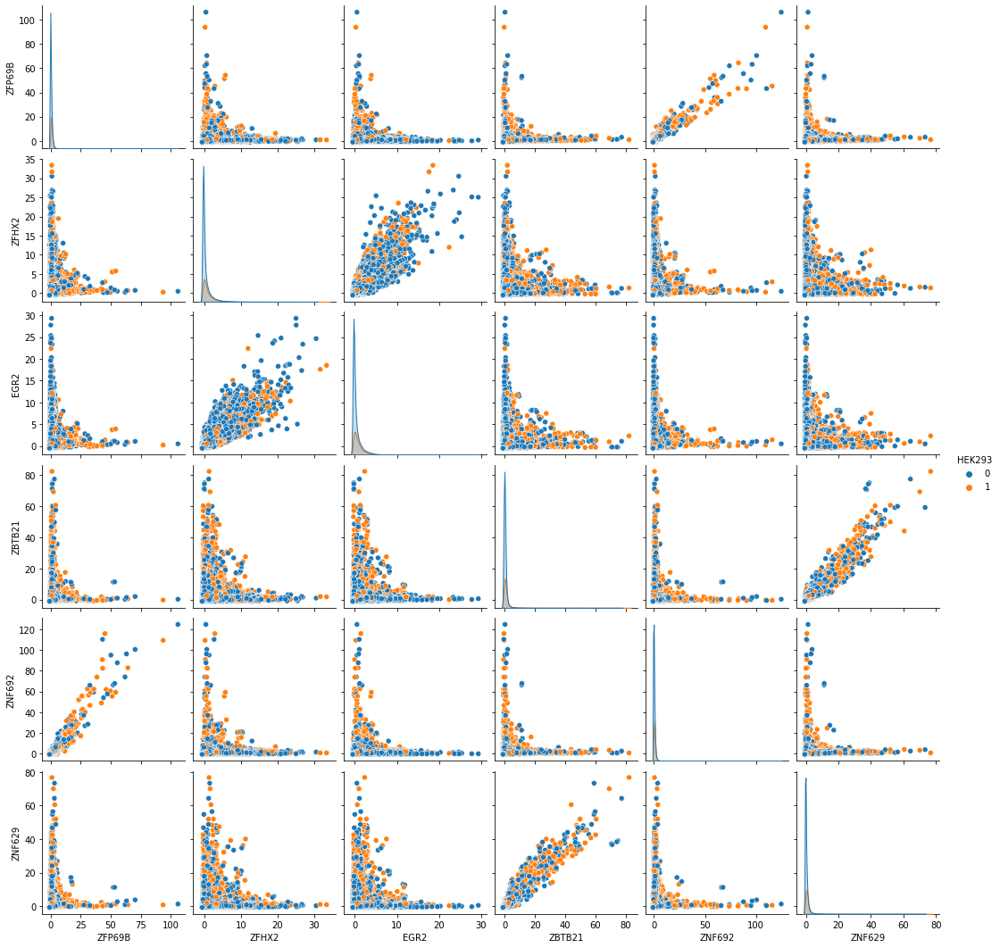

In [ ]:
firsts, seconds, _ = list(zip(*correlation_scores['promoters'][:3]))
columns = list(set(firsts+seconds))
print(f"Most correlated features from promoters")
sns.pairplot(pd.concat([
    epigenomes['promoters'][columns],
    labels['promoters'],
], axis=1), hue=labels['promoters'].columns[0])
plt.show()

Most correlated features from enhancers


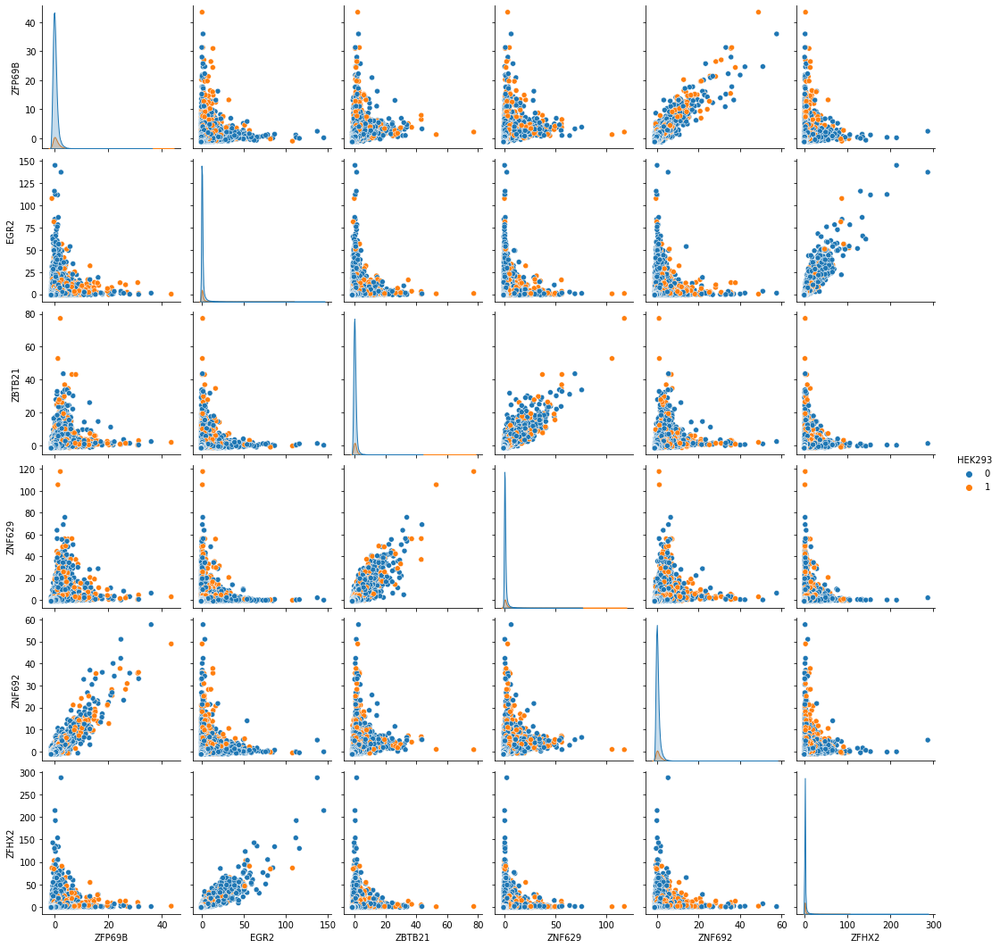

In [ ]:
firsts, seconds, _ = list(zip(*correlation_scores['enhancers'][:3]))
columns = list(set(firsts+seconds))
print(f"Most correlated features from enhancers")
sns.pairplot(pd.concat([
    epigenomes['enhancers'][columns],
    labels['enhancers'],
], axis=1), hue=labels['enhancers'].columns[0])
plt.show()

# **FEATURE DISTRIBUTIONS**

The following histograms show the distributions of the most different five features in the enhancers and promoters datasets.

In [ ]:
def get_top_most_different(dist, n:int):
    return np.argsort(
      -np.mean(dist, axis=1).flatten())[:n]

In [ ]:
from matplotlib.lines import Line2D
lines_legend = [Line2D([0], [0], color='red', lw=4),
                Line2D([0], [0], color='green', lw=4)]



def get_distributions(X,y,region,top_number = 8):
        dist = euclidean_distances(X.T)
        most_distance_columns_indices = get_top_most_different(dist, top_number)
        columns = X.columns[most_distance_columns_indices]
        fig, axes = plt.subplots(nrows=1, ncols=5, figsize=(25, 5))
        print(f"Top {top_number} different features from {region}")
        for column, axis in zip(columns, axes.flatten()):
            head, tail = X[column].quantile([0.05, 0.95]).values.ravel()
        
            mask = ((X[column] < tail) & (X[column] > head)).values
            cleared_x = X[column][mask]
            cleared_y = y.values.ravel()[mask]
        
            cleared_x[cleared_y==0].hist(ax=axis, bins=20, color='red')
            cleared_x[cleared_y==1].hist(ax=axis, bins=20, color='green')

            axis.set_title(column)
        fig.legend(lines_legend, ['negative','positive'])
        fig.tight_layout()
        plt.show()

Top 8 different features from promoters


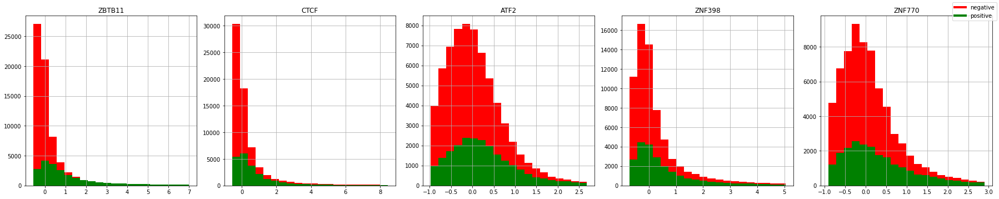

Top 8 different features from enhancers


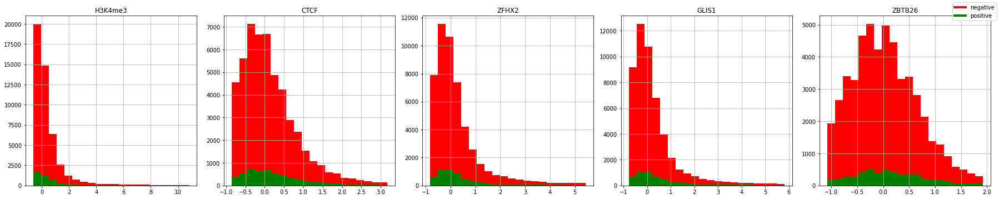

In [ ]:
for region in ['promoters','enhancers']:
    get_distributions(epigenomes[region],labels[region],region)

# **t-SNE feature visualization**

t-SNE is a technique of dimensionality reduction, which we will use for data visulaization, with the aim to identify patterns and clusters in datasets.
We will apply it on both sequence and epigenomic data

In [ ]:
pip install tsnecuda==3.0.0+cu110 -f https://tsnecuda.isx.ai/tsnecuda_stable.html --no-dependencies 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://tsnecuda.isx.ai/tsnecuda_stable.html
  Using cached https://s3.us-west-1.wasabisys.com/tsnecuda/tsnecuda-3.0.0%2Bcu110-py3-none-any.whl (55.4 MB)
  Attempting uninstall: tsnecuda
    Found existing installation: tsnecuda 3.0.1
    Uninstalling tsnecuda-3.0.1:
      Successfully uninstalled tsnecuda-3.0.1


In [ ]:
!pip install --target=$nb_path tsnecuda==3.0.0+cu110 -f https://tsnecuda.isx.ai/tsnecuda_stable.html --no-dependencies 


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://tsnecuda.isx.ai/tsnecuda_stable.html
  Using cached https://s3.us-west-1.wasabisys.com/tsnecuda/tsnecuda-3.0.0%2Bcu110-py3-none-any.whl (55.4 MB)


In [ ]:

def get_tsne_decomposition(
    X: pd.DataFrame,
    data_type: str,
    region: str,
    cell_line: str,
    metric: str,
)->pd.DataFrame:
    """Return the 2D TSNE decomposition of the given data."""
    # The import of the TSNECUDA is within the method and not
    # outside because it is hard to install the package
    from tsnecuda import TSNE
    return pd.DataFrame(
        TSNE(
            n_components=2,
            verbose=True
        ).fit_transform(X.values),
        index=X.index
    )

In [ ]:
from matplotlib.figure import Figure,Axes
def create_scatterplot(
    decomposition: pd.DataFrame,
    labels: np.ndarray,
    figure: Figure,
    ax: Axes
  ):
        plot = sns.scatterplot(x=decomposition.loc[:,0], y=decomposition.loc[:,1], hue=labels,
                     palette=sns.color_palette("hls", 2), ax=ax)
        
        

Metrics:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


Task:   0%|          | 0/2 [00:00<?, ?it/s]

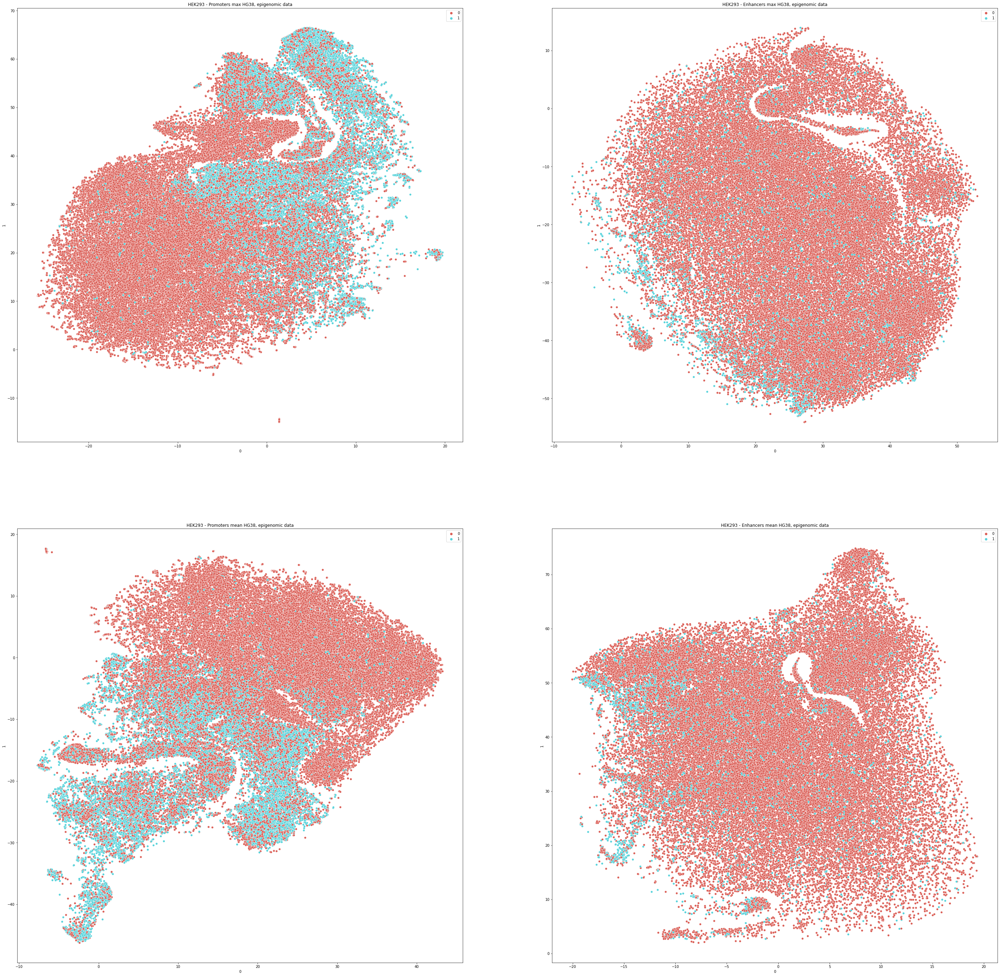

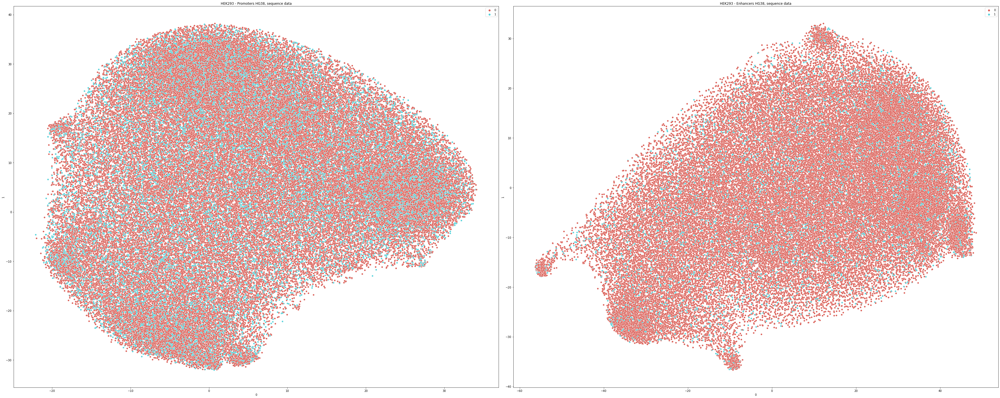

In [ ]:
from epigenomic_dataset import active_enhancers_vs_inactive_enhancers, active_promoters_vs_inactive_promoters
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import KNNImputer
from keras_bed_sequence import BedSequence
from tsnecuda import TSNE

epigenomic_fig, epigenomic_axes = plt.subplots(
    nrows=2,
    ncols=2,
    figsize=(50,50),
    squeeze=False
)

sequence_fig, sequence_axes = plt.subplots(
    nrows=1,
    ncols=2,
    figsize=(50,20),
    squeeze=False
)

for k, metric in enumerate(tqdm(("max", "mean"), desc="Metrics", leave=False)):
          for j, ((epigenomic, labels), region) in enumerate(tqdm((
              (active_promoters_vs_inactive_promoters(binarize=True,metric=metric,cell_line=cell_line, window_size=256,min_active_tpm_value= 1,max_inactive_tpm_value=1), "Promoters"),
               (active_enhancers_vs_inactive_enhancers(binarize=True,metric=metric,cell_line=cell_line, window_size=256,min_active_tpm_value= 0, max_inactive_tpm_value=0),"Enhancers")
          ), desc="Task", leave=False)):
                imputed_epigenomic = pd.DataFrame(
                    MinMaxScaler().fit_transform(
                        KNNImputer().fit_transform(epigenomic)
                    ),
                    columns=epigenomic.columns,
                    index=epigenomic.index
                )
                decomposed_epigenomic = get_tsne_decomposition(
                    imputed_epigenomic,
                    "epigenomic",
                    region,
                    cell_line,
                    metric
                )
                create_scatterplot(
                    decomposition=decomposed_epigenomic,
                    labels=labels.values.astype(int).ravel(),
                    figure=epigenomic_fig,
                    ax=epigenomic_axes[k][j]
                )
                epigenomic_axes[k][j].set_title(f"{cell_line} - {region} {metric} HG38, epigenomic data")
                
                
                if k==0:
                    sequence = pd.DataFrame(
                        np.array(BedSequence(
                            genome,
                            bed=to_bed(labels),
                            batch_size=1
                        )).reshape(-1, 4*256),
                        index=labels.index
                    )
                    decomposed_sequence = get_tsne_decomposition(
                        sequence,
                        "sequence",
                        region,
                        cell_line,
                        metric="None",
                        
                    )
                    create_scatterplot(
                      decomposition=decomposed_sequence,
                      labels=labels.values.astype(int).ravel(),
                      figure=sequence_fig,
                      ax=sequence_axes[0][j]
                )
                    sequence_axes[0][j].set_title(f"{cell_line} - {region} HG38, sequence data")
                   
plt.tight_layout()
plt.show()
                    

# **FEATURE SELECTION**

The goal of feature selection  is to find the best set of features that allows to build useful models. 

Boruta is a feature selection method that trains a random forest classifier  or regression and computes  a feature importance metric to evaluate the importance of each feature. 
Because of its computational expensiveness, I didn’t perform Boruta.


In [ ]:
pip install boruta

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 56 kB 2.7 MB/s 


In [ ]:
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from boruta import BorutaPy
from multiprocessing import cpu_count

@Cache(
    cache_path=[
        "boruta/kept_features_{_hash}.json",
        "boruta/discarded_features_{_hash}.json"
    ],
    args_to_ignore=[
        "X_train", "y_train"
    ]
)
def execute_boruta_feature_selection(
    X_train: pd.DataFrame,
    y_train: np.ndarray,
    holdout_number: int,
    task_name: str,
    max_iter: int = 100
):
    """Returns tuple with list of kept features and list of discared features.
    
    Parameters
    --------------------------
    X_train: pd.DataFrame,
        The data reserved for the input of the training of the Boruta model.
    y_train: np.ndarray,
        The data reserved for the output of the training of the Boruta model.
    holdout_number: int,
        The current holdout number.
    regression: bool,
        Whether the task is a binary classification one (False) or a regression one (True).
    task_name: str,
        The name of the task.
    max_iter: int = 100,
        Number of iterations to run Boruta for.
    """
    # According to the requested task we build either a random forest regressor
    # or a random forest classifier.
    
    model = RandomForestClassifier(n_jobs=cpu_count(), class_weight='balanced_subsample', max_depth=5)
    
    # Create the Boruta model
    boruta_selector = BorutaPy(
        # Defining the model that Boruta should use.
        model,
        # We leave the number of estimators to be decided by Boruta
        n_estimators='auto',
        verbose=False,
        alpha=0.05, # p_value
        # In practice one would run at least 100-200 times,
        # until all tentative features are exausted.
        max_iter=max_iter, 
        random_state=42,
    )
    # Fit the Boruta model
    boruta_selector.fit(X_train, y_train)
    
    # Get the kept features and discarded features
    kept_features = list(X_train.columns[boruta_selector.support_])
    discarded_features = list(X_train.columns[~boruta_selector.support_])
    
    # Filter out the unused featured.
    return kept_features, discarded_features

# **MODEL EVALUATION**

HOLDOUTS

Stratified holdout is a variation of simple hold-out,in which each class is represented by the same percentage of samples in the training set and in the test set.

I adopted the method StratifiedShuffleSplit from the machine learning library Scikit-learn.
It creates a generator of indexes that we can apply on the dataset in order to split it into the training and test sets. The selected percentage of the test set is 30% and the chosen number of iteration is 2 because performing many iterations (i.e. 10) could be very computationally heavy.


In [29]:
from sklearn.model_selection import StratifiedShuffleSplit

# Here for speed sake we are only doing two holdouts
# but normally at least 10 are executed
number_of_splits = 2

holdouts_generator = StratifiedShuffleSplit(
    n_splits=number_of_splits,
    test_size=0.3
)



FFNN

To see if the usage of the mean as aggregation metric inside the epigenomic dataset produces a different model's performance compared to the max, we will apply FFNN on epigenomic dataset, considering both the metrics.

In [20]:
def get_ffnn_sequence(
    X: np.ndarray,
    y: np.ndarray,
    batch_size: int = 1024
) -> MixedSequence:
    return MixedSequence(
        x={
            "epigenomic_data": VectorSequence(
                X,
                batch_size
            )
        },
        y=VectorSequence(
            y,
            batch_size=batch_size
        )
    )



In [21]:
def train_model_ffnn(
    model: Model,
    model_name: str,
    task: str,
    metric: str,
    cell_line: str,
    training_sequence: MixedSequence,
    test_sequence: MixedSequence,
    holdout_number: int
) -> Tuple[pd.DataFrame, pd.DataFrame]:
    
    history = pd.DataFrame(model.fit(
        train_sequence,
        validation_data=test_sequence,
        epochs=1000,
        verbose=False,
        callbacks=[
            EarlyStopping(
                "loss",
                min_delta=0.001,
                patience=2,
                mode="min"
            ),
           
        ]
    ).history)
    
    train_evaluation = dict(zip(model.metrics_names, model.evaluate(train_sequence, verbose=False)))
    test_evaluation = dict(zip(model.metrics_names, model.evaluate(test_sequence, verbose=False)))
    train_evaluation["run_type"] = "train"
    test_evaluation["run_type"] = "test"
    
    for evaluation in (train_evaluation, test_evaluation):
        evaluation["model_name"] = model_name
        evaluation["metric"] = metric
        evaluation["task"] = task
        evaluation["holdout_number"] = holdout_number
    
    evaluations = pd.DataFrame([
        train_evaluation,
        test_evaluation
    ])
    
    return history, evaluations

In [22]:
def build_ffnn(input_shape: int)->Tuple[Model,Layer,Layer]:
    
    input_epigenomic_data = Input(shape=(input_shape,), name="epigenomic_data")
    hidden_ffnn = Dense(80, activation="linear")(input_epigenomic_data)
    hidden_ffnn=BatchNormalization()(hidden_ffnn)
    hidden_ffnn= ReLU()(hidden_ffnn)
    hidden_ffnn = Dropout(rate=0.2)(hidden_ffnn)

    
    hidden_ffnn = Dense(60,activation="relu")(hidden_ffnn)
    hidden_ffnn = Dropout(rate=0.2)(hidden_ffnn)
    
    hidden_ffnn = Dense(40,activation="relu")(hidden_ffnn)
    hidden_ffnn = Dropout(rate=0.2)(hidden_ffnn)
    
    hidden_ffnn = Dense(20,activation="relu")(hidden_ffnn)
    hidden_ffnn = Dropout(rate=0.2)(hidden_ffnn)
    
   
    last_hidden_ffnn = hidden_ffnn
    output_ffnn = Dense(1, activation="sigmoid")(hidden_ffnn)
    
    ffnn = Model(
        inputs=input_epigenomic_data,
        outputs=output_ffnn,
        name="FFNN"
    )

    ffnn.compile(
        optimizer="nadam",
        loss="binary_crossentropy",
        metrics=get_complete_binary_metrics()
    )
    return ffnn, input_epigenomic_data, last_hidden_ffnn

In [ ]:
from tqdm.auto import tqdm
from epigenomic_dataset import active_enhancers_vs_inactive_enhancers, active_promoters_vs_inactive_promoters
from epigenomic_dataset.utils import normalize_epigenomic_data

# Create a list to store all the computed performance
ffnn_performance = []

ffnn_training_histories = {}



for metric in tqdm(['mean','max'],desc="Metric"):
    ffnn_training_histories[metric]= {}
    for task, threshold in tqdm((
        (active_enhancers_vs_inactive_enhancers, 0),
        (active_promoters_vs_inactive_promoters, 1),

    ), desc="Tasks"):
        task_name = task.__name__
        # We get the task data with binarized labels
        X, y = task(
        binarize=True,
        cell_line=cell_line,
        window_size=window_size,
        min_active_tpm_value=threshold,
        max_inactive_tpm_value=threshold,
        metric=metric
        )
        ffnn_training_histories[metric][task_name]= []
        # Extract the bed coordinates from the epigenomic dataset
       

        # Start the main loop, iterating through the holdouts
        for holdout_number, (train_indices, test_indices) in tqdm(
            enumerate(holdouts_generator.split(X, y)),
            total=number_of_splits,
            leave=False,
            desc="Computing holdouts"
        ):
            # Get the training and test data
            train_X, test_X = X.iloc[train_indices], X.iloc[test_indices]
            train_y, test_y = y.iloc[train_indices], y.iloc[test_indices]
            # Impute and normalize the epigenomic data
            train_X = robust_zscoring(knn_imputation(train_X))
            test_X= robust_zscoring(knn_imputation(test_X))
            #find features of the training set which are uncorrelated with the output
            uncorrelated=correlation_with_output(train_X,train_y)
            #eliminate the uncorrelated features
            train_X=eliminate_features(train_X,uncorrelated)
            #find the highly correlated features
            scores,features_correlated=correlation_between_features(train_X)
            #eliminate the extremely correlated features
            train_X=eliminate_features(train_X,features_correlated)
            #drop all the features eliminated in the training set
            test_X= eliminate_features(test_X,uncorrelated)
            test_X= eliminate_features(test_X,features_correlated)
            train_X = train_X.to_numpy()
            test_X=test_X.to_numpy()
        
            # Get the number of features of this specific dataset
            number_of_features = train_X.shape[1]
        
        
            # Flatten the output values
            train_y = train_y.values.flatten()
            test_y = test_y.values.flatten()
        
     
            ffnn, input_epigenomic_data, last_hidden_ffnn = build_ffnn(number_of_features)
            
            for model, train_sequence, test_sequence in tqdm(
                (
                
                (ffnn, get_ffnn_sequence(train_X, train_y), get_ffnn_sequence(test_X, test_y)),
                
                ),
                desc="Training models",
                leave=False
            ):
            
            # We compute the model performance
                history, performance = train_model_ffnn(
                    model,
                    model.name,
                    task_name,
                    metric,
                    cell_line,
                    train_sequence,
                    test_sequence,
                    holdout_number
                )
                ffnn_training_histories[metric][task_name].append(history)
                # We chain the computed performance to the performance list
                ffnn_performance.append(performance)
                
        
# We convert the computed performance list into a DataFrame
ffnn_performance = pd.concat(ffnn_performance)


Metric:   0%|          | 0/2 [00:00<?, ?it/s]

Tasks:   0%|          | 0/2 [00:00<?, ?it/s]

Computing holdouts:   0%|          | 0/2 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/26 [00:00<?, ?it/s]

ZBTB49 0.004932979026122729
ZNF211 0.005238994028183954
ZNF140 0.004480817868478092
ZNF138 0.004157674462123081
ZNF157 0.005789842880577809
ZNF530 0.00563193691288187
ZNF791 0.004953834862502938
ZNF670 0.0041356791765802614
ZNF169 0.005274820396034333
ZNF677 0.006169076167494281
ZFP41 0.004597123043807476
ZNF404 0.004511663576489638
PRDM2 0.0034199744388058342
ZNF549 0.005008393719710788
ZNF777 0.005350720246571462
ZNF426 0.004420822991740031
ZNF433 0.004802061403933036
ZNF704 0.0045051319752582005
ZNF416 0.005171160363758133
ZNF292 0.0045607875383648815
ZNF23 0.0036809458222365446
ZNF768 0.004604091381770401
BCL6B 0.007857725604753724
ZSCAN26 0.003577766498250563
ZNF202 0.005475913071903362
ZNF155 0.004450365570774726


Training models:   0%|          | 0/1 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/29 [00:00<?, ?it/s]

ZBTB49 0.004581526238467063
ZNF211 0.005256310013519379
ZNF140 0.0042032824048977135
ZNF138 0.004150367372539177
ZNF157 0.005595230726879119
ZNF530 0.005058424376457298
ZNF791 0.005380986531467831
ZNF670 0.004480518477846848
ZNF169 0.005096997454977376
ZNF548 0.0052251065682720164
ZNF677 0.0053439503721705245
ZNF404 0.00439539403871022
PRDM2 0.0039605428739491015
ZNF549 0.004698406945664921
ZNF777 0.005499909380703843
ZNF214 0.003791249005299485
ZNF426 0.004222243223098985
ZNF433 0.005083077242861507
ZNF19 0.004113779851462032
ZNF624 0.004481786293044611
ZNF416 0.005018882766065285
ZNF292 0.00485278187331633
ZNF23 0.0042331719374078345
ZNF768 0.005234109112270934
BCL6B 0.007294023848315582
ZNF266 0.005413697837186766
ZNF202 0.005961642637534432
ZNF626 0.005213512876377675
ZNF155 0.0041565577300578405


Training models:   0%|          | 0/1 [00:00<?, ?it/s]

Computing holdouts:   0%|          | 0/2 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/7 [00:00<?, ?it/s]

ZNF549 0.007379026459675661
ZNF302 0.004471445046661886
ZNF223 0.009935432763645674
AEBP2 0.0040436056963084315
ZNF704 0.009564077674698539
ZNF677 0.012633818465200262
ZNF34 0.003940286736292973


Training models:   0%|          | 0/1 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/6 [00:00<?, ?it/s]

ZNF549 0.007071191684226439
ZNF302 0.0042438659298842255
ZNF223 0.009581094160245083
AEBP2 0.003912417406021302
ZNF677 0.012600217086077156
ZNF34 0.004153847497544773


Training models:   0%|          | 0/1 [00:00<?, ?it/s]

Tasks:   0%|          | 0/2 [00:00<?, ?it/s]

Computing holdouts:   0%|          | 0/2 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/26 [00:00<?, ?it/s]

ZBTB49 0.004512729085386038
ZNF211 0.005142746753533395
ZNF138 0.004538718590101844
ZNF157 0.005696026805733225
ZNF530 0.004965648534758273
ZNF670 0.003961521571185089
ZNF169 0.005487262930849818
ZNF677 0.005980264376919784
ZFP41 0.003676614936202675
ZNF404 0.00503314571011098
PRDM2 0.0033965939301263248
ZNF549 0.005681138380974559
ZNF777 0.005882465178460114
ZNF214 0.004266443717399322
ZNF426 0.003615040247599882
ZNF433 0.005309487406942402
ZNF704 0.004746052986611438
ZNF19 0.0048340587202691625
ZNF416 0.005264396827661595
ZNF23 0.0038720406655068113
ZNF768 0.004616727964768071
BCL6B 0.007346184888934026
ZSCAN26 0.003992585655462949
ZNF202 0.0058564011636967955
ZNF626 0.005151051026982871
ZNF155 0.00451436485801736


Training models:   0%|          | 0/1 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/28 [00:00<?, ?it/s]

ZBTB49 0.00472302171471855
ZNF211 0.005073514220289357
ZNF140 0.0049005173894658026
ZNF138 0.004038238282668026
ZNF530 0.005344130071474765
ZNF791 0.005205234209892518
ZNF670 0.0040513528923671865
ZNF169 0.005276178213173111
ZNF548 0.005146205723943331
ZNF677 0.005774610524119439
ZNF404 0.004971614536808406
PRDM2 0.0028057262474005455
ZNF549 0.004798290926791225
ZNF777 0.006027535324140219
ZNF214 0.0038460201113178164
ZNF426 0.004383277278612406
ZNF433 0.005253246478363579
ZNF704 0.004398041000501057
ZNF19 0.00444879610508865
ZNF416 0.005051266679355615
ZNF292 0.00469418943783082
ZNF23 0.003806483468981339
ZNF768 0.004870642748859575
BCL6B 0.007250994250315922
ZSCAN26 0.003959971862637101
ZNF202 0.005749643873680829
ZNF626 0.005559330547717983
ZNF155 0.0047664417516522575


Training models:   0%|          | 0/1 [00:00<?, ?it/s]

Computing holdouts:   0%|          | 0/2 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/6 [00:00<?, ?it/s]

ZNF549 0.007190328721514176
ZNF302 0.004184876032602589
ZNF223 0.008790329200029761
AEBP2 0.004080317613621444
ZNF677 0.012888164942622325
ZNF34 0.004004691018550578


Training models:   0%|          | 0/1 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/6 [00:00<?, ?it/s]

ZNF549 0.006845517523581318
ZNF302 0.004225466810915929
ZNF223 0.008760829667775982
AEBP2 0.0038293920799629265
ZNF677 0.012363071105891686
ZNF34 0.0037650652346198367


Training models:   0%|          | 0/1 [00:00<?, ?it/s]

CNN

In [23]:
def get_cnn_sequence(
    genome: Genome,
    bed: pd.DataFrame,
    y: np.ndarray,
    batch_size: int = 1024
) -> MixedSequence:
    
    return MixedSequence(
        x={
            "sequence_data": BedSequence(
                genome,
                bed,
                batch_size=batch_size,
            )
        },
        y=VectorSequence(
            y,
            batch_size=batch_size
        )
    )

In [24]:
def build_cnn(window_size: int)-> Tuple[Model,Layer,Layer]:
    input_sequence_data = Input(shape=(window_size, 4), name="sequence_data")
    hidden_cnn = Conv1D(24, kernel_size=4, activation="relu", )(input_sequence_data)
    hidden_cnn = Dropout(rate=0.2)(hidden_cnn)
    hidden_cnn = MaxPool1D(pool_size=2, strides=2)(hidden_cnn)

    hidden_cnn = Conv1D(filters=48,kernel_size=6,activation="relu")(hidden_cnn)
    hidden_cnn = Dropout(rate=0.2)(hidden_cnn)
    hidden_cnn = MaxPool1D(pool_size=2, strides=2)(hidden_cnn)

    hidden_cnn = Conv1D(filters=72,kernel_size=8,activation="relu")(hidden_cnn)
    hidden_cnn = Dropout(rate=0.2)(hidden_cnn)
    hidden_cnn = MaxPool1D(pool_size=2, strides=2)(hidden_cnn)
    
    hidden_cnn = Conv1D(filters=96,kernel_size=10,activation="relu")(hidden_cnn)
    hidden_cnn = Dropout(rate=0.2)(hidden_cnn)
    hidden_cnn = MaxPool1D(pool_size=2, strides=2)(hidden_cnn)

    
       
    hidden_cnn = Flatten()(hidden_cnn)
    hidden_cnn = Dense(64, activation="relu")(hidden_cnn)
    hidden_cnn= Dropout(rate=0.3)(hidden_cnn)
    hidden_cnn = Dense(32, activation="relu")(hidden_cnn)
    hidden_cnn= Dropout(rate=0.3)(hidden_cnn)
    hidden_cnn = Dense(16, activation="relu")(hidden_cnn)
    hidden_cnn= Dropout(rate=0.3)(hidden_cnn)
    last_hidden_cnn = hidden_cnn
    output_cnn = Dense(1, activation="sigmoid")(last_hidden_cnn)
    
    
    cnn = Model(
        inputs=input_sequence_data,
        outputs=output_cnn,
        name="CNN"
    )

    cnn.compile(
        optimizer="nadam",
        loss="binary_crossentropy",
        metrics=get_complete_binary_metrics()
    )
    return cnn, input_sequence_data, last_hidden_cnn

MMNN

Since executing a Multimodal neural network is really computationally expensive, I will adopt ,as metric for the epigenomic data , the mean and  256, as window size for both epigenomic and sequence data.

In [25]:
def get_mmnn_sequence(
    genome: Genome,
    bed: pd.DataFrame,
    X: np.ndarray,
    y: np.ndarray,
    batch_size: int = 1024
) -> MixedSequence:
   
    return MixedSequence(
        x={
            "sequence_data": BedSequence(
                genome,
                bed,
                batch_size=batch_size,
            ),
            "epigenomic_data": VectorSequence(
                X,
                batch_size
            )
        },
        y=VectorSequence(
            y,
            batch_size=batch_size
        )
    )


In [26]:
def build_mmnn(
    input_shape: Optional[int] = None,
    window_size: Optional[int] = None,
    input_epigenomic_data: Optional[Layer] = None,
    input_sequence_data: Optional[Layer] = None,
    last_hidden_ffnn: Optional[Layer] = None,
    last_hidden_cnn: Optional[Layer] = None,
):

    if input_shape is None and (last_hidden_ffnn is None or input_epigenomic_data is None):
        raise ValueError(
            "Either the input shape or the features selection layer and the input epigenomic "
            "layer must be provided."
        )
    if window_size is None and (last_hidden_cnn is None or input_sequence_data is None):
        raise ValueError(
            "Either the input shape or the features selection layer and the input sequence "
            "layer must be provided."
        )
        
    if input_shape is not None:
        _, input_epigenomic_data, last_hidden_ffnn = build_ffnn(input_shape)
        
    if window_size is not None:
        _, input_sequence_data, last_hidden_cnn = build_cnn(window_size)
        
    concatenation_layer = Concatenate()([
        last_hidden_ffnn,
        last_hidden_cnn
    ])
    hidden_mmnn= Dense(80, activation="relu")(concatenation_layer)
    hidden_mmnn=Dropout(rate=0.3)(hidden_mmnn)
    hidden_mmnn= Dense(60, activation="relu")(hidden_mmnn)
    hidden_mmnn=Dropout(rate=0.3)(hidden_mmnn)
    hidden_mmnn= Dense(40, activation="relu")(concatenation_layer)
    hidden_mmnn=Dropout(rate=0.3)(hidden_mmnn)
    hidden_mmnn= Dense(20, activation="relu")(hidden_mmnn)
    hidden_mmnn=Dropout(rate=0.3)(hidden_mmnn)
    last_hidden_mmnn = hidden_mmnn
    output_mmnn = Dense(1, activation="sigmoid")(last_hidden_mmnn)

    mmnn = Model(
        inputs=[input_epigenomic_data, input_sequence_data],
        outputs=output_mmnn,
        name="BoostedMMNN" if input_shape is None else "MMNN"
    )

    mmnn.compile(
        optimizer="nadam",
        loss="binary_crossentropy",
        metrics=get_complete_binary_metrics()
    )

    return mmnn

In [27]:

def train_model(
    model: Model,
    model_name: str,
    task: str,
    cell_line: str,
    training_sequence: MixedSequence,
    test_sequence: MixedSequence,
    holdout_number: int
) -> Tuple[pd.DataFrame, pd.DataFrame]:
    
    history = pd.DataFrame(model.fit(
        train_sequence,
        validation_data=test_sequence,
        epochs=1000,
        verbose=False,
        callbacks=[
            EarlyStopping(
                "loss",
                min_delta=0.001,
                patience=2,
                mode="min"
            ),
           
        ]
    ).history)
    
    train_evaluation = dict(zip(model.metrics_names, model.evaluate(train_sequence, verbose=False)))
    test_evaluation = dict(zip(model.metrics_names, model.evaluate(test_sequence, verbose=False)))
    train_evaluation["run_type"] = "train"
    test_evaluation["run_type"] = "test"
    
    for evaluation in (train_evaluation, test_evaluation):
        evaluation["model_name"] = model_name
        evaluation["task"] = task
        evaluation["holdout_number"] = holdout_number
    
    evaluations = pd.DataFrame([
        train_evaluation,
        test_evaluation
    ])
    
    return history, evaluations

In [30]:
from tqdm.auto import tqdm
from epigenomic_dataset import active_enhancers_vs_inactive_enhancers, active_promoters_vs_inactive_promoters
from epigenomic_dataset.utils import normalize_epigenomic_data

# Create a list to store all the computed performance
all_performance = []

training_histories = {}


# For each task
for task, threshold in tqdm((
    (active_enhancers_vs_inactive_enhancers, 0),
    (active_promoters_vs_inactive_promoters, 1),

), desc="Tasks"):
    task_name = task.__name__
    # We get the task data with binarized labels
    X, y = task(
        binarize=True,
        cell_line=cell_line,
        window_size=window_size,
        min_active_tpm_value=threshold,
        max_inactive_tpm_value=threshold
    )
    training_histories[task_name] = []
    # Extract the bed coordinates from the epigenomic dataset
    bed = to_bed(X)

    # Start the main loop, iterating through the holdouts
    for holdout_number, (train_indices, test_indices) in tqdm(
        enumerate(holdouts_generator.split(X, y)),
        total=number_of_splits,
        leave=False,
        desc="Computing holdouts"
    ):
        # Get the training and test data
        train_bed, test_bed = bed.iloc[train_indices], bed.iloc[test_indices]
        train_X, test_X = X.iloc[train_indices], X.iloc[test_indices]
        train_y, test_y = y.iloc[train_indices], y.iloc[test_indices]
        # Impute and normalize the epigenomic data
        train_X = robust_zscoring(knn_imputation(train_X))
        test_X= robust_zscoring(knn_imputation(test_X))
        #find features of the training set which are uncorrelated with the output
        uncorrelated=correlation_with_output(train_X,train_y)
        #eliminate the uncorrelated features
        train_X=eliminate_features(train_X,uncorrelated)
        #find the highly correlated features
        scores,features_correlated=correlation_between_features(train_X)
        #eliminate the extremely correlated features
        train_X=eliminate_features(train_X,features_correlated)
        #drop all the features eliminated in the training set
        test_X= eliminate_features(test_X,uncorrelated)
        test_X= eliminate_features(test_X,features_correlated)
        train_X = train_X.to_numpy()
        test_X=test_X.to_numpy()
        
        # Get the number of features of this specific dataset
        number_of_features = train_X.shape[1]
        
        
        # Flatten the output values
        train_y = train_y.values.flatten()
        test_y = test_y.values.flatten()
        
     
        ffnn, input_epigenomic_data, last_hidden_ffnn = build_ffnn(number_of_features)
        cnn, input_sequence_data, last_hidden_cnn = build_cnn(window_size)
        mmnn1 = build_mmnn(number_of_features, window_size)
        mmnn2 = build_mmnn(
            input_sequence_data=input_sequence_data,
            input_epigenomic_data=input_epigenomic_data,
            last_hidden_ffnn=last_hidden_ffnn,
            last_hidden_cnn=last_hidden_cnn
        )
        for model, train_sequence, test_sequence in tqdm(
            (
                
                (ffnn, get_ffnn_sequence(train_X, train_y), get_ffnn_sequence(test_X, test_y)),
                (cnn, get_cnn_sequence(genome, train_bed, train_y), get_cnn_sequence(genome, test_bed, test_y)),
                (mmnn1, get_mmnn_sequence(genome, train_bed, train_X, train_y), get_mmnn_sequence(genome, test_bed, test_X, test_y)),
                (mmnn2, get_mmnn_sequence(genome, train_bed, train_X, train_y), get_mmnn_sequence(genome, test_bed, test_X, test_y)),
            ),
            desc="Training models",
            leave=False
        ):
            #I skipped Boruta because it is computationally expensive
            history, performance = train_model(
                model,
                model.name,
                task_name,
                cell_line,
                train_sequence,
                test_sequence,
                holdout_number
            )
            training_histories[task_name].append(history)
            # We chain the computed performance to the performance list
            all_performance.append(performance)
            
        
# We convert the computed performance list into a DataFrame
all_performance = pd.concat(all_performance)


Tasks:   0%|          | 0/2 [00:00<?, ?it/s]

Computing holdouts:   0%|          | 0/2 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/27 [00:00<?, ?it/s]

ZNF677 0.005875789900994447
ZNF19 0.004795989907631619
ZBTB49 0.0042258331343859
ZNF155 0.00463931024074219
ZNF157 0.006161890971170489
PRDM2 0.003333719623866198
ZNF549 0.005057464477536367
ZNF211 0.005564620274467369
ZNF292 0.00499818709175797
ZNF138 0.0043324043591470894
BCL6B 0.008337063724444094
ZNF169 0.005464696497499397
ZNF433 0.005371531431400796
ZNF404 0.0048929760218016935
ZNF416 0.005264423611970605
ZNF768 0.005214674299608564
ZNF214 0.004108350270808602
ZNF626 0.00516204849694748
ZNF530 0.005359607025902036
ZNF548 0.005199963762033908
ZNF791 0.0054182665656023095
ZNF140 0.004721055172761767
ZNF777 0.005629040923244571
ZNF426 0.0045678401661309875
ZNF23 0.0038740310911958803
ZNF202 0.005539664243916745
ZNF670 0.004531933492428329


/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


Training models:   0%|          | 0/4 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/26 [00:00<?, ?it/s]

ZNF677 0.006149235166096173
ZBTB49 0.004968932190402392
ZNF155 0.004174147439509615
ZFP41 0.004217673002450574
ZNF157 0.00544459737127476
PRDM2 0.0033437465505781433
ZNF549 0.005763170386368545
ZNF211 0.0050596838467914865
ZNF292 0.005064552098710159
BCL6B 0.00823026562956357
ZNF169 0.005068039673700855
ZNF433 0.00521952945603237
ZNF404 0.00526429426140356
ZNF416 0.005019704481068212
ZNF768 0.005177198734106802
ZNF626 0.0054025869554347825
ZSCAN26 0.003955890855050728
ZNF530 0.004899652635535803
ZNF548 0.005243938158066671
ZNF791 0.005274411752552427
ZNF140 0.00505301577063813
ZNF777 0.0061547830171444036
ZNF426 0.0043661319561222895
ZNF23 0.004075176820709456
ZNF202 0.0054851732240137115
ZNF670 0.0035888251755946156


Training models:   0%|          | 0/4 [00:00<?, ?it/s]

Computing holdouts:   0%|          | 0/2 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/5 [00:00<?, ?it/s]

ZNF223 0.00921266081448508
AEBP2 0.003886641857901807
ZNF302 0.004536124084326147
ZNF34 0.0037875792518205593
ZNF549 0.00701042903311723


Training models:   0%|          | 0/4 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/6 [00:00<?, ?it/s]

ZNF223 0.009011719276910055
ZNF677 0.012201775707660801
AEBP2 0.0036082577692804455
ZNF302 0.004503256003763824
ZNF34 0.00363231352245083
ZNF549 0.0077215926951304985


Training models:   0%|          | 0/4 [00:00<?, ?it/s]

# **RESULTS**

In this last part, we use the barplots and plot_keras_history packages to visualize the results of the executed models.

Also we perform Wilconxon test to check if the models, considering their performance, are statistically indistinguishable.

FFNN- COMPARISON OF MODEL'S PERFORMANCE WITH MEAN OR MAX AS AGGREGATION METRIC IN THE EPIGENOMIC DATA

In [ ]:
ffnn_performance


,loss,accuracy,recall,precision,AUROC,AUPRC,f1_score,balanced_accuracy,specificity,miss_rate,...,fowlkes_mallows_index,informedness,markedness,positive_likelyhood_ratio,negative_likelyhood_ratio,DOR,run_type,model_name,task,holdout_number
0,0.330763,0.895009,0.000000,0.000000,0.604229,0.188672,0.000000,0.500000,1.000000,1.000000,...,0.500000,0.000000,-0.104991,0.000000,1.000000,1.000000,train,BinaryClassificationCNN,active_enhancers_vs_inactive_enhancers,0
1,0.334985,0.895028,0.000000,0.000000,0.576540,0.174408,0.000000,0.500000,1.000000,1.000000,...,0.500000,0.000000,-0.104972,0.000000,1.000000,1.000000,test,BinaryClassificationCNN,active_enhancers_vs_inactive_enhancers,0
0,0.327596,0.895009,0.000000,0.000000,0.578740,0.176800,0.000000,0.500000,1.000000,1.000000,...,0.500000,0.000000,-0.104991,0.000000,1.000000,1.000000,train,BinaryClassificationCNN,active_enhancers_vs_inactive_enhancers,1
1,0.329174,0.895028,0.000000,0.000000,0.571759,0.169693,0.000000,0.500000,1.000000,1.000000,...,0.500000,0.000000,-0.104972,0.000000,1.000000,1.000000,test,BinaryClassificationCNN,active_enhancers_vs_inactive_enhancers,1
0,0.452652,0.761871,0.115306,0.671715,0.810953,0.546026,0.196826,0.548108,0.980909,0.884694,...,0.548108,0.278304,0.437681,6.039847,0.901912,1.212917,train,BinaryClassificationCNN,active_promoters_vs_inactive_promoters,0
1,0.470504,0.758618,0.105249,0.639936,0.789352,0.517748,0.180768,0.542595,0.979940,0.894751,...,0.542595,0.259524,0.403708,5.246732,0.913067,1.186245,test,BinaryClassificationCNN,active_promoters_vs_inactive_promoters,0
0,0.472050,0.746953,0.000000,0.000000,0.769729,0.449488,0.000000,0.500000,1.000000,1.000000,...,0.500000,0.000000,-0.253047,0.000000,1.000000,1.000000,train,BinaryClassificationCNN,active_promoters_vs_inactive_promoters,1
1,0.470975,0.746971,0.000000,0.000000,0.769400,0.447397,0.000000,0.500000,1.000000,1.000000,...,0.500000,0.000000,-0.253029,0.000000,1.000000,1.000000,test,BinaryClassificationCNN,active_promoters_vs_inactive_promoters,1


In [ ]:
from barplots import barplots

barplots(
   ffnn_performance.drop(columns=["holdout_number"]),
    groupby=["metric", "task", "run_type",],
    orientation="horizontal",
    height=8,
    subplots=True,

WILCOXON TEST

In [ ]:
for task in ffnn_performance.task.unique():
    print("*"*80)
    print(task)
    print("*"*80)
    model_A = ffnn_performance.metric.unique()[0]
    model_A_performance =ffnn_performance[(ffnn_performance.metric=='mean') & (ffnn_performance.run_type=="test")&(ffnn_performance.task==task)]
    model_B=ffnn_performance.metric.unique()[1]
    model_B_performance =ffnn_performance[(ffnn_performance.metric=='max') & (ffnn_performance.run_type=="test")&(ffnn_performance.task==task)]
    for met in ('AUROC','AUPRC','accuracy'):
        _, p_value=wilcoxon(model_A_performance[met],model_B_performance[met])
        if p_value <0.05 :
            if model_A_performance[met].mean()> model_B_performance[met].mean():
                best_model,worse_model=model_A,model_B
            else:
                best_model,worse_model=model_B,model_A
                print(f"The metric {model_A} outperforms the metric {worse_model} with p_value {p_value} on metric {metric} ")
        else:
             print(f"The metric {model_A} is statistically indistinguishable from {model_B} with p_value {p_value} on metric {met}")
  

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Created wheel for plot-keras-history: filename=plot_keras_history-1.1.36-py3-none-any.whl size=9236 sha256=b6ac86faa9626277e8b18cbe1c16facc841d99a84b0769490bc9d58fb98dc143
  Stored in directory: /root/.cache/pip/wheels/ca/73/ed/41022b42c1d9ce60a8a2ebb71f042c7f895673760404d39fd7
Successfully built plot-keras-history


ALL RESULTS

In [31]:
all_performance

,loss,accuracy,recall,precision,AUROC,AUPRC,f1_score,balanced_accuracy,specificity,miss_rate,...,fowlkes_mallows_index,informedness,markedness,positive_likelyhood_ratio,negative_likelyhood_ratio,DOR,run_type,model_name,task,holdout_number
0,0.290145,0.900449,0.092668,0.694042,0.752413,0.347545,0.163505,0.543938,0.995208,0.907332,...,0.543938,0.253605,0.597426,19.337019,0.911701,1.192684,train,FFNN,active_enhancers_vs_inactive_enhancers,0
1,0.302960,0.900980,0.099849,0.698246,0.693402,0.312558,0.174715,0.547394,0.994939,0.900151,...,0.547394,0.264044,0.602315,19.729168,0.904729,1.209428,test,FFNN,active_enhancers_vs_inactive_enhancers,0
0,0.324700,0.895009,0.000000,0.000000,0.638717,0.200946,0.000000,0.500000,1.000000,1.000000,...,0.500000,0.000000,-0.104991,0.000000,1.000000,1.000000,train,CNN,active_enhancers_vs_inactive_enhancers,0
1,0.327947,0.895028,0.000000,0.000000,0.590415,0.180409,0.000000,0.500000,1.000000,1.000000,...,0.500000,0.000000,-0.104972,0.000000,1.000000,1.000000,test,CNN,active_enhancers_vs_inactive_enhancers,0
0,0.292705,0.899546,0.067297,0.736471,0.743014,0.339561,0.123325,0.532236,0.997175,0.932703,...,0.532236,0.222626,0.637597,23.822420,0.935345,1.137831,train,MMNN,active_enhancers_vs_inactive_enhancers,0
1,0.301517,0.900084,0.071249,0.755319,0.701149,0.316007,0.130215,0.534271,0.997293,0.928751,...,0.534271,0.231983,0.656851,26.319475,0.931271,1.147172,test,MMNN,active_enhancers_vs_inactive_enhancers,0
0,0.244495,0.901104,0.080198,0.783613,0.894695,0.510994,0.145504,0.538800,0.997402,0.919802,...,0.538800,0.250687,0.685993,30.869516,0.922198,1.168256,train,BoostedMMNN,active_enhancers_vs_inactive_enhancers,0
1,0.328775,0.900506,0.077772,0.752427,0.655456,0.294499,0.140973,0.537385,0.996999,0.922228,...,0.537385,0.241905,0.654557,25.912529,0.925004,1.161627,test,BoostedMMNN,active_enhancers_vs_inactive_enhancers,0
0,0.273283,0.902616,0.113094,0.735664,0.801397,0.408573,0.196049,0.554164,0.995233,0.886906,...,0.554164,0.288443,0.641019,23.724102,0.891154,1.242975,train,FFNN,active_enhancers_vs_inactive_enhancers,1
1,0.310280,0.898715,0.091320,0.619048,0.680813,0.283020,0.159160,0.542364,0.993409,0.908680,...,0.542364,0.237763,0.522161,13.855096,0.914709,1.185144,test,FFNN,active_enhancers_vs_inactive_enhancers,1


In [94]:

cnn_training_histories={}
for task in all_performance.task.unique():
    cnn_training_histories[task]=[]
    for i in [1,5]:
        cnn_training_histories[task].append(training_histories[task][i])


ffnn_training_histories={}
for task in all_performance.task.unique():
    ffnn_training_histories[task]=[]
    for i in [0,4]:
        ffnn_training_histories[task].append(training_histories[task][i])

mmnn_training_histories={}
for task in all_performance.task.unique():
    mmnn_training_histories[task]=[]
    for i in [2,3,6,7]:
        mmnn_training_histories[task].append(training_histories[task][i])



(<Figure size 1440x2520 with 28 Axes>,
 array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f0e0670dd50>,
       dtype=object))

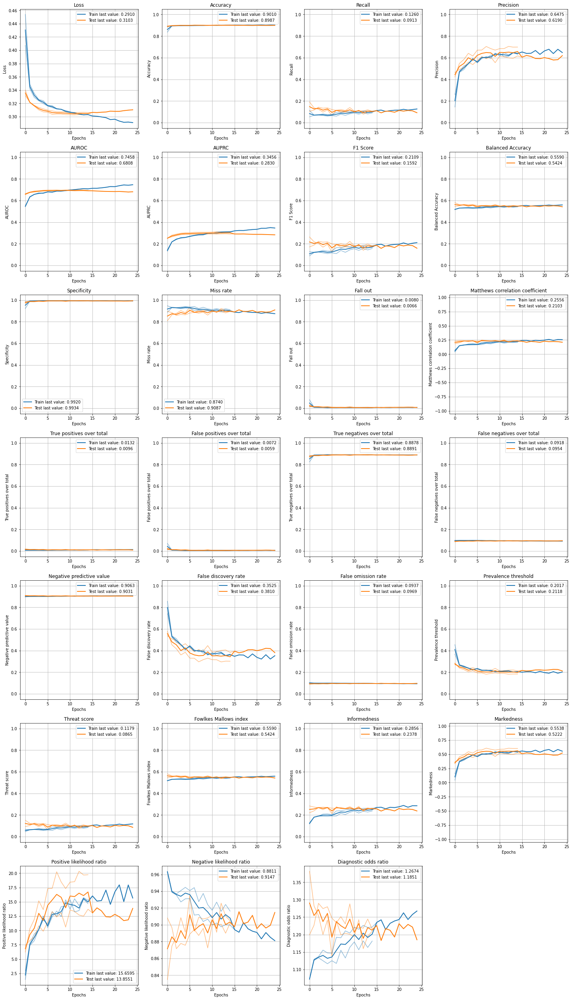

In [86]:
from plot_keras_history import plot_history
plot_history(ffnn_training_histories['active_enhancers_vs_inactive_enhancers'])

(<Figure size 1440x2520 with 28 Axes>,
 array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f0c4054ff90>,
       dtype=object))

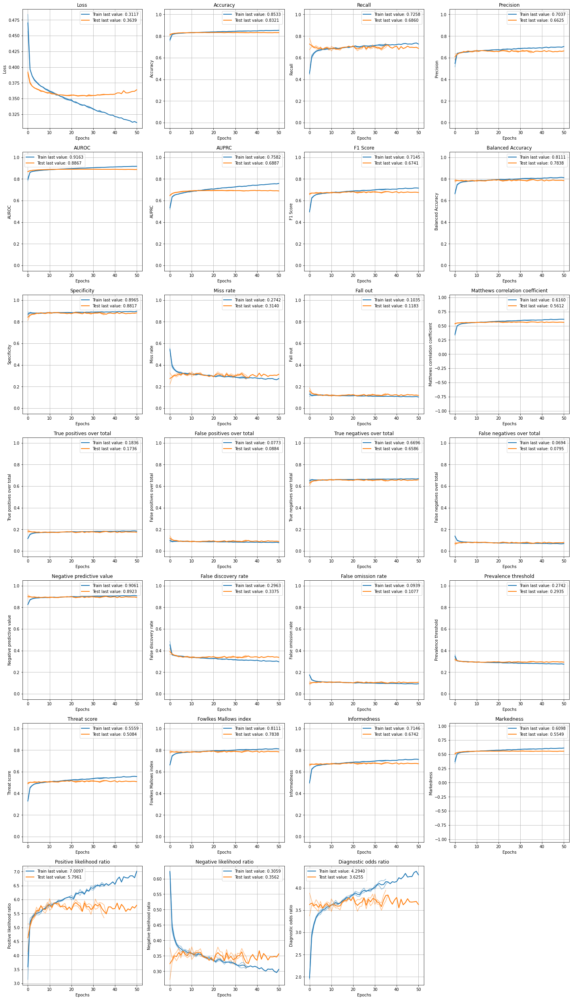

In [87]:
from plot_keras_history import plot_history
plot_history(ffnn_training_histories['active_promoters_vs_inactive_promoters'])

/usr/local/lib/python3.7/dist-packages/plot_keras_history/plot_keras_history.py:111: UserWarning: Please be advised that you have provided a metric called `prevalence_threshold` that is expected to be normalized, i.e. between 0 and 1. The values you have provided for this metric were between 0.000 and 1.001.
  max_value=max_value


(<Figure size 1440x2520 with 28 Axes>,
 array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f0c3f6aea10>,
       dtype=object))

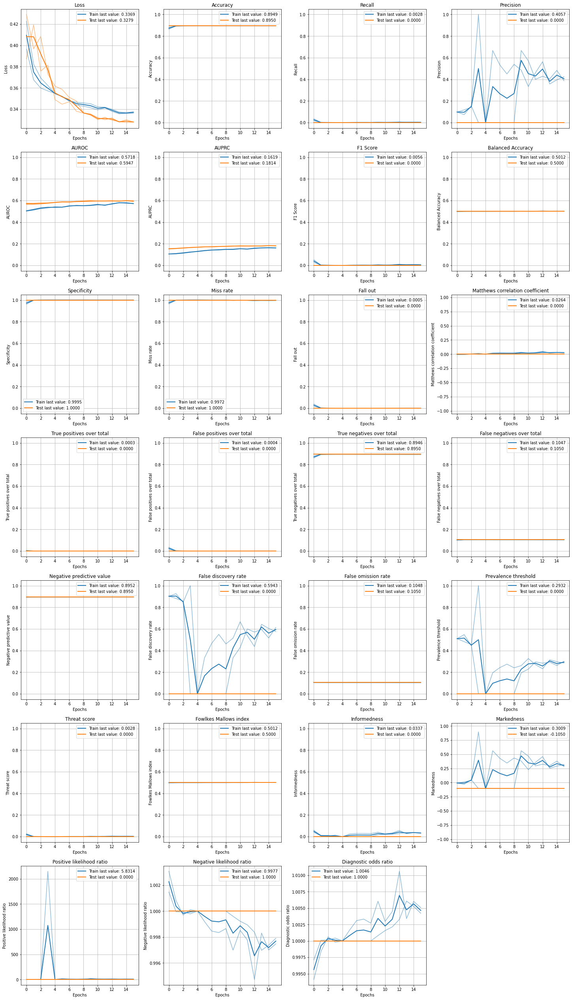

In [88]:
from plot_keras_history import plot_history
plot_history(cnn_training_histories['active_enhancers_vs_inactive_enhancers'])

(<Figure size 1440x2520 with 28 Axes>,
 array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f0e12fc2150>,
       dtype=object))

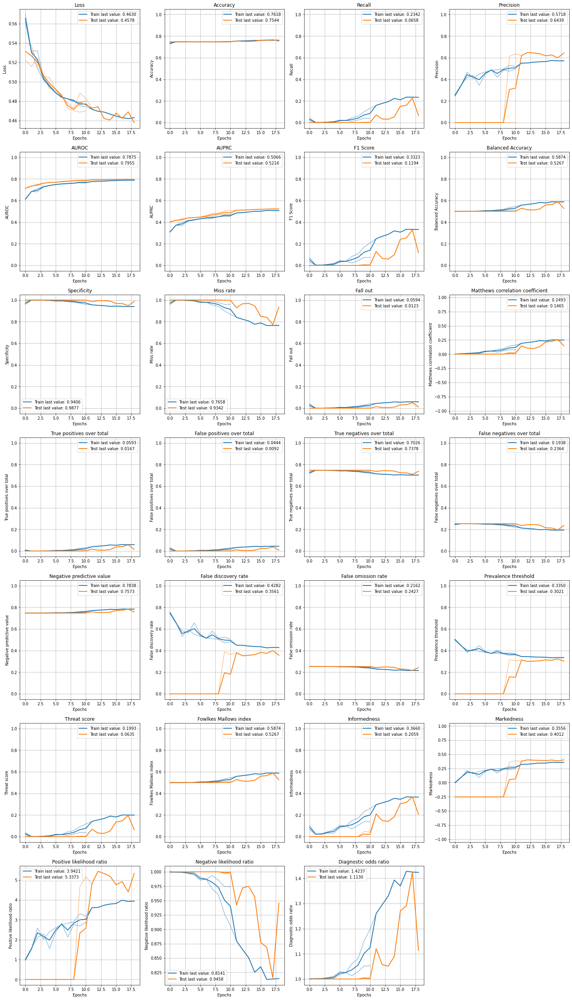

In [89]:
from plot_keras_history import plot_history
plot_history(cnn_training_histories['active_promoters_vs_inactive_promoters'])

(<Figure size 1440x2520 with 28 Axes>,
 array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f0c3953c690>,
       dtype=object))

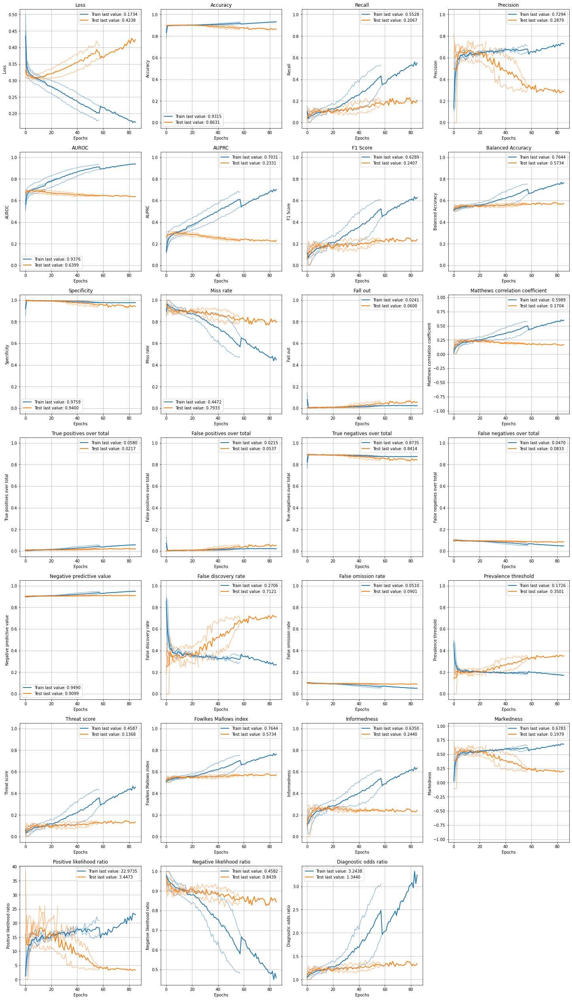

In [98]:
from plot_keras_history import plot_history
plot_history(mmnn_training_histories['active_enhancers_vs_inactive_enhancers'])

(<Figure size 1440x2520 with 28 Axes>,
 array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f0c3b5c7750>,
       dtype=object))

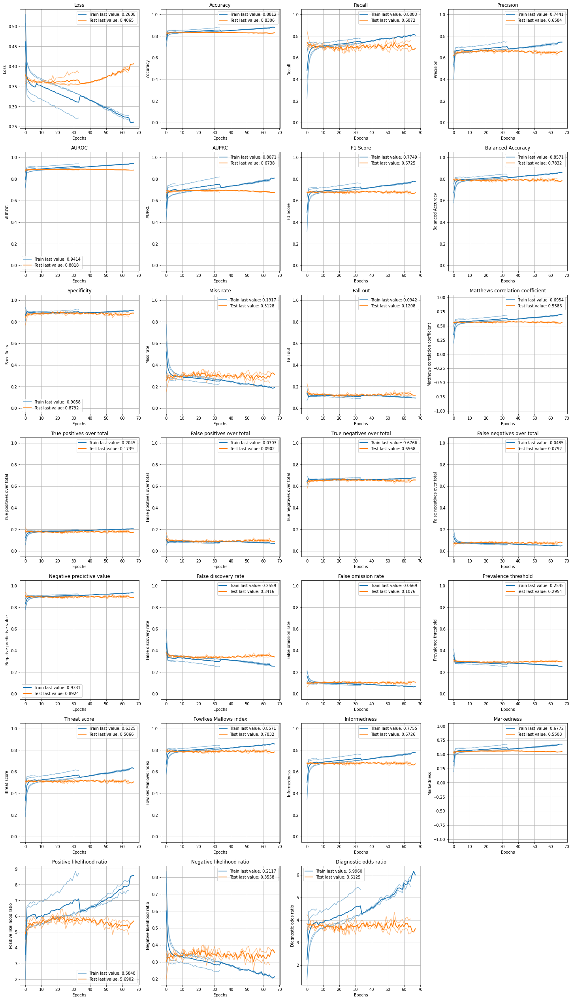

In [95]:
from plot_keras_history import plot_history
plot_history(mmnn_training_histories['active_promoters_vs_inactive_promoters'])

(<Figure size 1440x2520 with 28 Axes>,
 array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f0c4df587d0>,
       dtype=object))

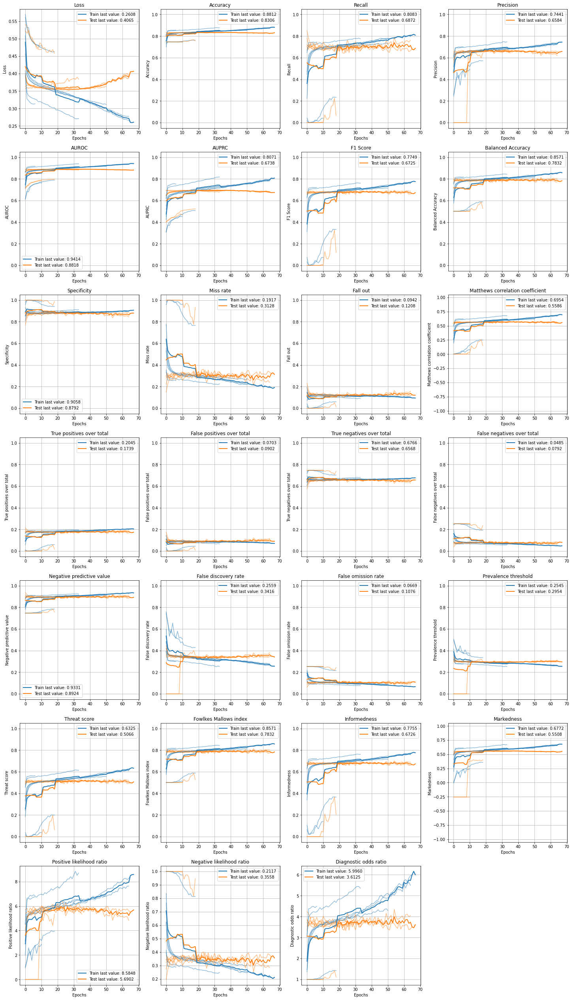

In [49]:
from plot_keras_history import plot_history
plot_history(training_histories['active_promoters_vs_inactive_promoters'])

Rendering barplots:   0%|          | 0/27 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/barplots/barplot.py:315: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  figure.tight_layout()
/usr/local/lib/python3.7/dist-packages/barplots/utils/get_axes.py:93: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  dpi=dpi


[(<Figure size 3200x120 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f0c505581d0>,
        dtype=object)),
 (<Figure size 3200x120 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f0c4f8bb250>,
        dtype=object)),
 (<Figure size 3200x120 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f0c4f77b0d0>,
        dtype=object)),
 (<Figure size 3200x120 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f0c4f68e110>,
        dtype=object)),
 (<Figure size 3200x120 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f0c4f742cd0>,
        dtype=object)),
 (<Figure size 3200x120 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f0c4f4f16d0>,
        dtype=object)),
 (<Figure size 3200x120 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f0c4f3de4d0>,
        dtype=object)),
 (<Figure size 3200x120 with 2 Axes>,
  a

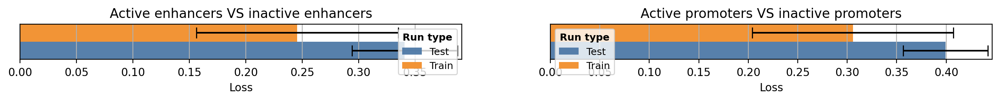

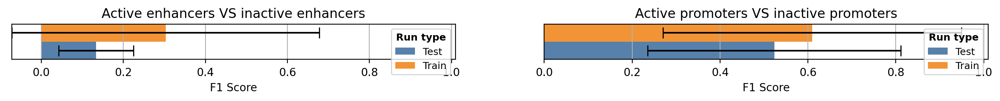

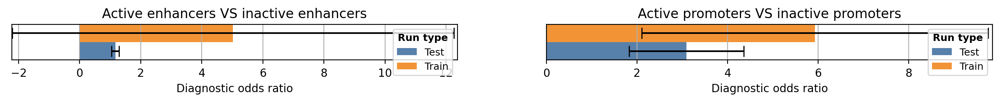

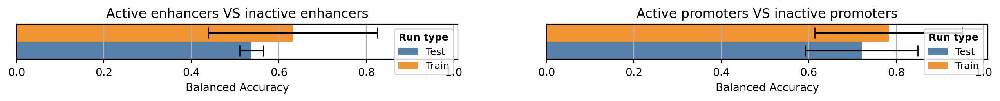

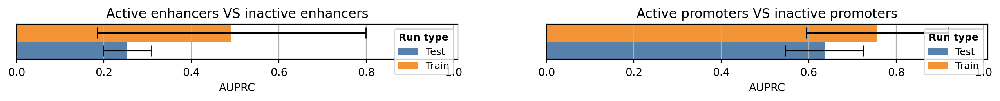

...

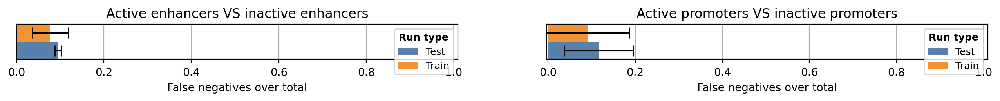

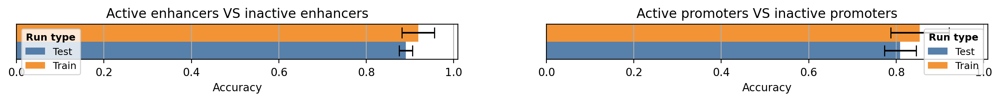

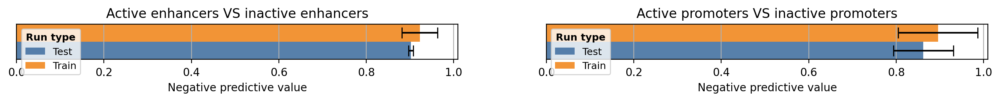

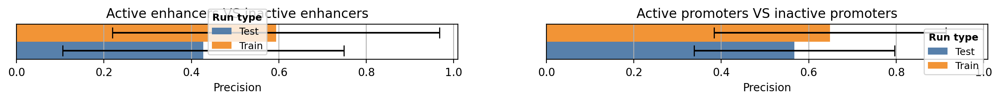

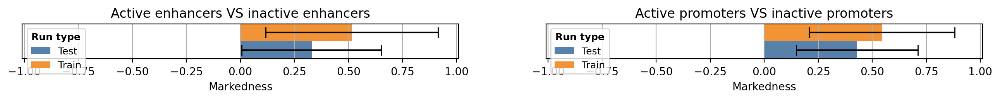

In [46]:
from barplots import barplots

barplots(
   all_performance.drop(columns=["holdout_number"]),
    groupby=["task",  "run_type"],
    orientation="horizontal",
    height=8,
    subplots=True,
)

WILCOXON TEST

In [48]:
for task in all_performance.task.unique():
  print("*"*80)
  print(task)
  print("*"*80)
  for i  in range(0,3):
    model_A = all_performance.model_name.unique()[i]
    model_A_performance =all_performance[(all_performance.model_name==model_A) & (all_performance.run_type=="test")&(all_performance.task==task)]
    for j in range(i+1,4):
      model_B=all_performance.model_name.unique()[j]
      model_B_performance =all_performance[(all_performance.model_name==model_B) & (all_performance.run_type=="test")&(all_performance.task==task)]
      for metric in ('AUROC','AUPRC','accuracy'):
          _,p_value=wilcoxon(model_A_performance[metric],model_B_performance[metric])
          if p_value <0.01 :
              if model_A_performance[metric].mean()> model_B_performance[metric].mean():
                    best_model,worse_model=model_A,model_B
              else:
                    best_model,worse_model=model_B,model_A
                    print(f"The model {best_model} outperforms the model {worse_model} with p_value {p_value} on metric {metric} ")
          else:
                print(f"The model {model_A} is statistically indistinguishable from {model_B} with p_value {p_value} on metric {metric}")
  






********************************************************************************
active_enhancers_vs_inactive_enhancers
********************************************************************************
The model FFNN is statistically indistinguishable from CNN with p_value 0.17971249487899976 on metric AUROC
The model FFNN is statistically indistinguishable from CNN with p_value 0.17971249487899976 on metric AUPRC
The model FFNN is statistically indistinguishable from CNN with p_value 0.17971249487899976 on metric accuracy
The model FFNN is statistically indistinguishable from MMNN with p_value 0.6547208460185769 on metric AUROC
The model FFNN is statistically indistinguishable from MMNN with p_value 0.6547208460185769 on metric AUPRC
The model FFNN is statistically indistinguishable from MMNN with p_value 0.17971249487899976 on metric accuracy
The model FFNN is statistically indistinguishable from BoostedMMNN with p_value 0.17971249487899976 on metric AUROC
The model FFNN is statistica

/usr/local/lib/python3.7/dist-packages/scipy/stats/morestats.py:2879: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")
